# Street Sign Detection using YOLOv8

## 1. Introduction


This notebook covers the implementation and evaluation of an object detector using YOLOv8 to detect Maltese traffic signs at street-level range.
The main objective of the detector is to be capable of localisinf traffic signs under real-world conditions and also to evaluate the perofrmance with use of standard metrics and suggested diagnostic tools.

### Import Libraries and Initialise YOLO version

In [ ]:
import sys
print(sys.executable)
%matplotlib inline

import torch 
torch.cuda.empty_cache
torch.cuda.reset_peak_memory_stats()
print(torch.__version__) 
print(torch.cuda.is_available()) 
print(torch.cuda.get_device_name(0))

import cv2
import math
import yaml
from IPython.display import display
from PIL import Image
from pathlib import Path
from ultralytics import YOLO
import matplotlib.pyplot as plt
import pandas as pd
from collections import Counter

model = YOLO("yolov8s.pt")

c:\Users\matth\miniconda3\envs\ARI3129\python.exe
2.5.1+cu121
True
NVIDIA GeForce RTX 3070


## 2. Model Training

In [2]:
model.train(
    data="C:/Users/matth/Desktop/CV_Assignment/dataset_FULL/YOLO_COCO/data.yaml",
    epochs=80,
    imgsz=640,
    batch=16,
    lr0=0.001,
    patience=15,
    name="Object_Detector_YOLOv8_MF",
    project="runs",
    exist_ok=True,
    verbose=True
)


New https://pypi.org/project/ultralytics/8.4.2 available  Update with 'pip install -U ultralytics'
Ultralytics 8.3.253  Python-3.10.19 torch-2.5.1+cu121 CUDA:0 (NVIDIA GeForce RTX 3070, 8192MiB)
engine\trainer: agnostic_nms=False, amp=True, augment=False, auto_augment=randaugment, batch=16, bgr=0.0, box=7.5, cache=False, cfg=None, classes=None, close_mosaic=10, cls=0.5, compile=False, conf=None, copy_paste=0.0, copy_paste_mode=flip, cos_lr=False, cutmix=0.0, data=C:/Users/matth/Desktop/CV_Assignment/dataset_FULL/YOLO_COCO/data.yaml, degrees=0.0, deterministic=True, device=None, dfl=1.5, dnn=False, dropout=0.0, dynamic=False, embed=None, epochs=80, erasing=0.4, exist_ok=True, fliplr=0.5, flipud=0.0, format=torchscript, fraction=1.0, freeze=None, half=False, hsv_h=0.015, hsv_s=0.7, hsv_v=0.4, imgsz=640, int8=False, iou=0.7, keras=False, kobj=1.0, line_width=None, lr0=0.001, lrf=0.01, mask_ratio=4, max_det=300, mixup=0.0, mode=train, model=yolov8s.pt, momentum=0.937, mosaic=1.0, multi_sca

ultralytics.utils.metrics.DetMetrics object with attributes:

ap_class_index: array([0, 1, 2, 3, 4, 5])
box: ultralytics.utils.metrics.Metric object
confusion_matrix: <ultralytics.utils.metrics.ConfusionMatrix object at 0x0000020713D9FAC0>
curves: ['Precision-Recall(B)', 'F1-Confidence(B)', 'Precision-Confidence(B)', 'Recall-Confidence(B)']
curves_results: [[array([          0,    0.001001,    0.002002,    0.003003,    0.004004,    0.005005,    0.006006,    0.007007,    0.008008,    0.009009,     0.01001,    0.011011,    0.012012,    0.013013,    0.014014,    0.015015,    0.016016,    0.017017,    0.018018,    0.019019,     0.02002,    0.021021,    0.022022,    0.023023,
          0.024024,    0.025025,    0.026026,    0.027027,    0.028028,    0.029029,     0.03003,    0.031031,    0.032032,    0.033033,    0.034034,    0.035035,    0.036036,    0.037037,    0.038038,    0.039039,     0.04004,    0.041041,    0.042042,    0.043043,    0.044044,    0.045045,    0.046046,    0.047047,
 

## 3. Model Evaluation

In [ ]:
metrics = model.val(data="dataset_FULL\YOLO_COCO\data.yaml", split="test")
metrics

results = model.predict(
    source="C:/Users/matth/Desktop/CV_Assignment/dataset_FULL/YOLO_COCO/images/test",
    conf=0.25,
    save=True
)

results_path = Path(r"runs\Object_Detector_YOLOv8_MF\results.csv")
results_df = pd.read_csv(results_path)
results_df.tail()


plt.figure(figsize=(10,4))
plt.plot(results_df['epoch'], results_df['metrics/mAP50(B)'], label='mAP@0.5')
plt.plot(results_df['epoch'], results_df['metrics/mAP50-95(B)'], label='mAP@0.5:0.95')
plt.xlabel("Epoch")
plt.ylabel("Score")
plt.title("Validation mAP over Epochs")
plt.legend()
plt.show()



Ultralytics 8.3.253  Python-3.10.19 torch-2.5.1+cu121 CUDA:0 (NVIDIA GeForce RTX 3070, 8192MiB)
val: Fast image access  (ping: 0.30.2 ms, read: 231.833.2 MB/s, size: 6045.8 KB)
val: Scanning C:\Users\matth\Desktop\CV_Assignment\dataset_FULL\YOLO_COCO\labels\test.cache... 138 images, 0 backgrounds, 0 corrupt: 100% ━━━━━━━━━━━━ 138/138  0.0s
val: C:\Users\matth\Desktop\CV_Assignment\dataset_FULL\YOLO_COCO\images\test\20251112_123519.jpg: corrupt JPEG restored and saved
val: C:\Users\matth\Desktop\CV_Assignment\dataset_FULL\YOLO_COCO\images\test\20251115_145701.jpg: corrupt JPEG restored and saved
val: C:\Users\matth\Desktop\CV_Assignment\dataset_FULL\YOLO_COCO\images\test\20251130_114922.jpg: corrupt JPEG restored and saved
val: C:\Users\matth\Desktop\CV_Assignment\dataset_FULL\YOLO_COCO\images\test\20251130_115024.jpg: corrupt JPEG restored and saved
val: C:\Users\matth\Desktop\CV_Assignment\dataset_FULL\YOLO_COCO\images\test\20251130_115050.jpg: corrupt JPEG restored and saved
val: C:\

<Figure size 1000x400 with 1 Axes>

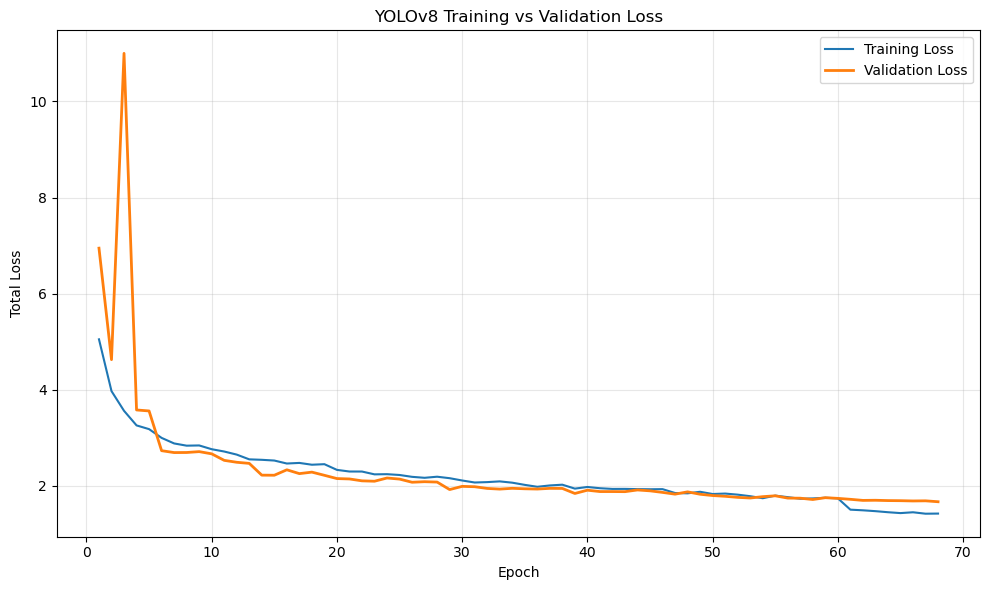

In [ ]:
# Path to YOLOv8 training results
RESULTS_CSV = r"C:\Users\matth\Desktop\CV_Assignment\runs\Object_Detector_YOLO12_PS\results.csv"

# Load results
df = pd.read_csv(RESULTS_CSV)

# Compute total losses
df["train_total_loss"] = (
    df["train/box_loss"] +
    df["train/cls_loss"] +
    df["train/dfl_loss"]
)

df["val_total_loss"] = (
    df["val/box_loss"] +
    df["val/cls_loss"] +
    df["val/dfl_loss"]
)

# Plot
plt.figure(figsize=(10, 6))
plt.plot(df["epoch"], df["train_total_loss"], label="Training Loss")
plt.plot(df["epoch"], df["val_total_loss"], label="Validation Loss", linewidth=2)

plt.xlabel("Epoch")
plt.ylabel("Total Loss")
plt.title("YOLOv8 Training vs Validation Loss")
plt.legend()
plt.grid(alpha=0.3)
plt.tight_layout()
plt.show()


In [ ]:
# Precision & Recall are per-class → take mean
precision = np.mean(metrics.box.p)
recall = np.mean(metrics.box.r)

# mAP metrics
map50 = metrics.box.map50
map5095 = metrics.box.map

# F1-score
f1 = 2 * (precision * recall) / (precision + recall + 1e-6)

# Inference time (ms per image)
inference_time_ms = metrics.speed["inference"]

# ---- Print results ----
print("YOLOv8 Evaluation Metrics")
print(f"Precision:      {precision:.4f}")
print(f"Recall:         {recall:.4f}")
print(f"F1-score:       {f1:.4f}")
print(f"mAP@50:         {map50:.4f}")
print(f"mAP@50–95:      {map5095:.4f}")
print(f"Inference (ms): {inference_time_ms:.2f}")


Ultralytics 8.3.253  Python-3.10.19 torch-2.5.1+cu121 CUDA:0 (NVIDIA GeForce RTX 3070, 8192MiB)
Model summary (fused): 72 layers, 11,127,906 parameters, 0 gradients, 28.4 GFLOPs
val: Fast image access  (ping: 0.10.0 ms, read: 2048.7493.8 MB/s, size: 4338.0 KB)
val: Scanning C:\Users\matth\Desktop\CV_Assignment\dataset_FULL\YOLO_COCO\labels\val.cache... 133 images, 0 backgrounds, 0 corrupt: 100% ━━━━━━━━━━━━ 133/133  0.0s
val: C:\Users\matth\Desktop\CV_Assignment\dataset_FULL\YOLO_COCO\images\val\20251112_124643.jpg: corrupt JPEG restored and saved
val: C:\Users\matth\Desktop\CV_Assignment\dataset_FULL\YOLO_COCO\images\val\20251130_115108.jpg: corrupt JPEG restored and saved
val: C:\Users\matth\Desktop\CV_Assignment\dataset_FULL\YOLO_COCO\images\val\20251130_115453.jpg: corrupt JPEG restored and saved
val: C:\Users\matth\Desktop\CV_Assignment\dataset_FULL\YOLO_COCO\images\val\20251130_115532.jpg: corrupt JPEG restored and saved
val: C:\Users\matth\Desktop\CV_Assignment\dataset_FULL\YOLO

## 4. Model Output

Found 138 predicted images


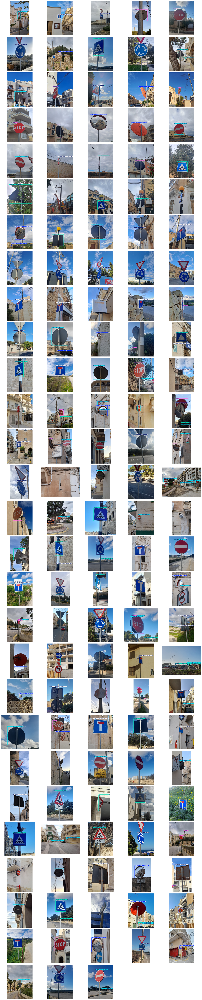

In [ ]:

PRED_DIR = Path("runs/detect/predict3")

images = sorted(PRED_DIR.glob("*.jpg"))
print(f"Found {len(images)} predicted images")

# Grid layout
cols = 5        
rows = math.ceil(len(images) / cols)

fig_height = rows * 3.5

fig, axes = plt.subplots(rows, cols, figsize=(20, fig_height))
axes = axes.ravel()

for ax, img_path in zip(axes, images):
    img = cv2.imread(str(img_path))
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

    ax.imshow(img)
    ax.axis("off")


for ax in axes[len(images):]:
    ax.axis("off")

plt.tight_layout()
plt.show()



### Predicitions Counter

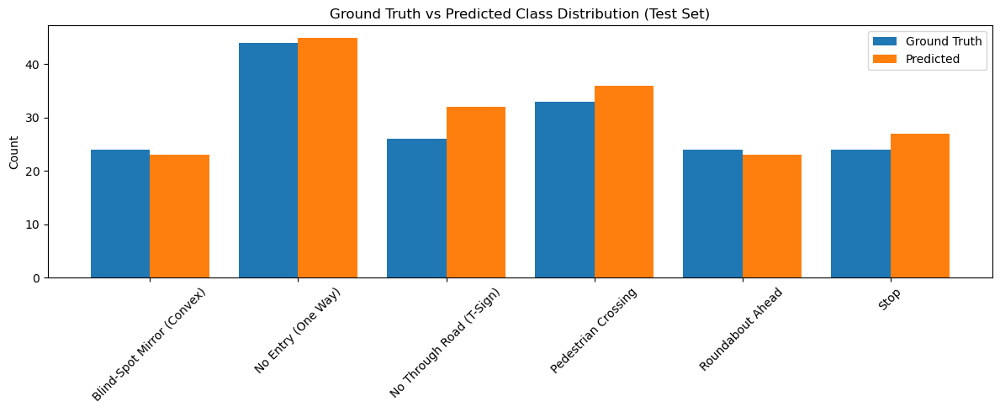

In [ ]:
# Load class names from dataset YAML
with open("C:/Users/matth/Desktop/CV_Assignment/dataset_FULL/YOLO_COCO/data.yaml", "r") as f:
    data_yaml = yaml.safe_load(f)

class_names = data_yaml["names"]

# Ground truth
gt_label_dir = Path("C:/Users/matth/Desktop/CV_Assignment/dataset_FULL/YOLO_COCO/labels/test")
gt_cls_ids = []

for label_file in gt_label_dir.glob("*.txt"):
    with open(label_file) as f:
        for line in f:
            cls_id = int(line.strip().split()[0])
            gt_cls_ids.append(cls_id)

gt_counts = Counter(gt_cls_ids)


pred_cls_ids = []

for r in results:
    if r.boxes is not None:
        pred_cls_ids.extend(r.boxes.cls.cpu().tolist())

pred_counts = Counter(pred_cls_ids)


all_cls_ids = sorted(set(gt_counts.keys()) | set(pred_counts.keys()))

data = []
for cid in all_cls_ids:
    data.append({
        "Class": class_names[cid],
        "Ground Truth": gt_counts.get(cid, 0),
        "Predicted": pred_counts.get(cid, 0)
    })

df = pd.DataFrame(data)

# Plot
plt.figure(figsize=(12,5))

x = range(len(df))
plt.bar(x, df["Ground Truth"], width=0.4, label="Ground Truth")
plt.bar([i + 0.4 for i in x], df["Predicted"], width=0.4, label="Predicted")

plt.xticks([i + 0.2 for i in x], df["Class"], rotation=45)
plt.ylabel("Count")
plt.title("Ground Truth vs Predicted Class Distribution (Test Set)")
plt.legend()
plt.tight_layout()
plt.show()
